<a href="https://colab.research.google.com/github/gabhijith/pyghack_covid19/blob/master/zipcode_visualizations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [3]:
#!pip install plotly-geo

In [4]:
#!pip install -U plotly 

In [5]:
#!pip install geopandas==0.3.0
#!pip install pyshp==1.2.10
#!pip install shapely==1.6.3

In [6]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/il_illinois_zip_codes_geo.min.json') as response:
    ilzip = json.load(response)

In [27]:
tmp = ilzip
cuzips = []
for i in range(len(tmp['features'])):
  if ilzip['features'][i]['properties']['ZCTA5CE10'] in list(zipdf['zipcode'].unique()):
    cuzips.append(ilzip['features'][i])

new_json = dict.fromkeys(['type','features'])
new_json['type'] = 'FeatureCollection'
new_json['features'] = cuzips

open('updated-fils.json','w').write(json.dumps(new_json,sort_keys=True,indent=4, separators=(',',':')))


53

In [28]:
import folium

In [ ]:
def create_map(table,zips,mapped_feature,add_text=''):
  cu_geo = r'updated-fils.json'
  m = folium.Map(location=[40.2139, 88.2461],zoom_start = 11)
  m.choropleth(
      geo_data = cu_geo,
      fill_opacity = 0.7,
      line_opacity = 0.2,
      data = table,
      key_on = 'feature.properties.ZCTA5CE10',
      columns=[zips,mapped_feature],
      fill_color = 'RdY1Gn',
      legend_name = (' ').join(mapped_feature.split('_')).title()+' '+add_text+'Across CU'
    
  )

In [24]:
ilzip['features'][5]['properties']['ZCTA5CE10']

'62262'

In [8]:
zipdf = pd.read_csv('/content/gdrive/My Drive/pyghack_data/Champaign_zipcode_demographics.csv')
zipdf.head()

,zipcode,city,population,pop_density,median_household_income,male,female,white,black,native,asian,hispanic,Unemployment_rate,no_edu,high_school,college_drop,college,poverty_rate
0,60949,ludlow,636,25,32303.0,0.49,0.51,0.926,0.020,0.000,0.016,0.014,8,18.0,65.0,10.0,8.0,NaN
1,61801,urbana,30937,5780,25647.0,0.51,0.49,0.592,0.140,0.002,0.214,0.021,2,6.0,28.0,3.0,61.0,NaN
2,61802,urbana,19052,230,43767.0,0.48,0.52,0.698,0.180,0.005,0.053,0.033,4,10.0,50.0,5.0,34.0,NaN
3,61815,bondville,228,779,35500.0,0.46,0.54,0.996,0.000,0.000,0.000,0.000,-1,6.8,78.9,8.7,5.6,NaN
4,61816,broadlands,509,18,71000.0,0.50,0.50,0.967,0.004,0.000,0.002,0.002,0,4.8,62.7,4.8,27.6,NaN


In [25]:
list(zipdf['zipcode'].unique())

[60949,
 61801,
 61802,
 61815,
 61816,
 61820,
 61821,
 61822,
 61840,
 61843,
 61845,
 61847,
 61849,
 61851,
 61852,
 61853,
 61859,
 61862,
 61863,
 61864,
 61866,
 61871,
 61872,
 61873,
 61874,
 61875,
 61877,
 61878,
 61880]

In [9]:
zipdf.columns.to_list()

['zipcode',
 'city',
 'population',
 'pop_density',
 'median_household_income',
 'male',
 'female',
 'white',
 'black',
 'native',
 'asian',
 'hispanic',
 'Unemployment_rate',
 'no_edu',
 'high_school',
 'college_drop',
 'college',
 'poverty_rate']

In [10]:
zipdf.pop_density.max()

5780

In [11]:
import plotly
print(plotly.__version__)

4.10.0


In [16]:
import plotly.express as px
fig = px.choropleth(zipdf, geojson=ilzip, locations='zipcode', color='pop_density',
                           color_continuous_scale="Viridis",
                           range_color=(0, 2000),
                           scope=['Illinois'],
                           labels={'pop_density':'population density'}
                          )

ValueError: ignored

In [13]:
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
import plotly.figure_factory as ff

In [ ]:
countydf = pd.read_csv('/content/gdrive/My Drive/pyghack_data/final_county_features.csv')

In [ ]:
countydf.head()

,fips,Unemployment_rate,Median_Household_Income,poverty_rate,no_edu,high_school,college_drop,college,land_area,total_pop,pop_density,cases,deaths,confirmed_cases,confirmed_deaths,probable_cases,probable_deaths,NEVER,RARELY,SOMETIMES,FREQUENTLY,ALWAYS,no_mask,death_rate,black,white,asian,native,hispanic,0,0-4,12-16,16-20,20-24,24-28,28-32,32-36,36-40,4-8,40-44,44-48,48-52,52-56,56-60,60-64,64-68,68-72,8-12,Female,Male
0,1001,2.7,59338.0,13.8,11.3,32.6,28.4,27.7,594.44,55869.0,93.985936,1738,25.0,1565.0,24.0,173.0,1.0,0.053,0.074,0.134,0.295,0.444,0.127,0.000447,0.202047,0.777900,0.015162,0.004892,0.029658,0.011636,0.048866,0.067535,0.057067,0.066635,0.062247,0.065251,0.065035,0.071330,0.061564,0.068542,0.070628,0.058218,0.046564,0.041564,0.031276,0.020557,0.015665,0.069819,0.514487,0.485513
1,1003,2.7,57588.0,9.8,9.7,27.6,31.3,31.3,1589.78,223234.0,140.418171,5165,50.0,4979.0,46.0,186.0,4.0,0.083,0.059,0.098,0.323,0.436,0.142,0.000224,0.093192,0.884649,0.013462,0.008696,0.046468,0.010343,0.044491,0.059315,0.050949,0.057201,0.055302,0.060343,0.059063,0.066328,0.058719,0.065324,0.072213,0.071851,0.065438,0.057201,0.038826,0.023227,0.019741,0.064127,0.515384,0.484616
2,1005,3.8,34382.0,30.9,27.0,35.7,25.1,12.2,884.88,24686.0,27.897568,857,7.0,657.0,7.0,200.0,0.0,0.067,0.121,0.120,0.201,0.491,0.188,0.000284,0.491861,0.494273,0.006632,0.007234,0.042764,0.010289,0.041317,0.058318,0.059162,0.072184,0.067119,0.061533,0.058277,0.065271,0.058197,0.064427,0.067320,0.061734,0.061895,0.053736,0.036454,0.023150,0.018970,0.060649,0.472168,0.527832
3,1007,3.1,46064.0,21.8,16.8,47.3,24.4,11.5,622.58,22394.0,35.969675,642,10.0,611.0,6.0,31.0,4.0,0.020,0.034,0.096,0.278,0.572,0.054,0.000447,0.217054,0.774509,0.004018,0.004420,0.026250,0.010982,0.046384,0.056696,0.058170,0.077054,0.071473,0.067500,0.064286,0.071339,0.052277,0.070580,0.068482,0.060848,0.052768,0.044286,0.032634,0.018839,0.016205,0.059196,0.467813,0.532188
4,1009,2.7,50412.0,13.2,19.8,34.0,33.5,12.6,644.78,57826.0,89.683303,1594,15.0,1236.0,15.0,358.0,0.0,0.053,0.114,0.180,0.194,0.459,0.167,0.000259,0.019225,0.968568,0.005187,0.007019,0.095712,0.011705,0.048115,0.063416,0.054945,0.061618,0.058264,0.060754,0.061428,0.067790,0.062846,0.067376,0.068240,0.063676,0.056743,0.051193,0.034059,0.022528,0.017842,0.067462,0.507261,0.492739


In [ ]:
fips = countydf['fips'].tolist()
values = countydf['Unemployment_rate'].tolist()

colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 12, len(colorscale) - 1))

In [ ]:
fig = ff.create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='USA by Unemployment %',
    legend_title='% unemployed'
)
fig.layout.template = None
fig.show()

In [ ]:
fips = countydf['fips'].tolist()
#death_minority = (countydf['confirmed_deaths']/(countydf['black']+countydf['hispanic'])).tolist()
death_minority = (countydf['confirmed_deaths']/(countydf['black'])).tolist()

colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.logspace(1, 5, len(colorscale) - 1))

In [ ]:
max(death_minority)

172737.46025260026

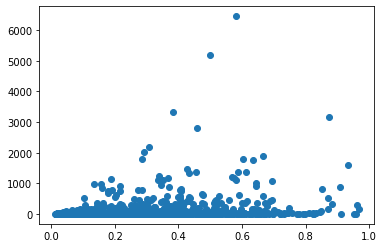

In [ ]:
plt.scatter(countydf['black']+countydf['hispanic'], countydf['confirmed_deaths'])

In [ ]:
fig = ff.create_choropleth(
    fips=fips, values=countydf['confirmed_deaths'].to_list(),
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='deaths per minority %',
    legend_title='deaths/minority'
)
fig.layout.template = None
fig.show()

In [ ]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import plotly.express as px

In [ ]:
fig = px.choropleth_mapbox(countydf, geojson=counties, locations='fips', color='deaths',
                           color_continuous_scale="Viridis",
                           range_color=(0, 50),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
counties.keys()

dict_keys(['type', 'features'])

In [ ]:
cdf = pd.read_csv('/content/gdrive/My Drive/pyghack_data/il-covid-counts-by-zipcode-9_24_2020.csv')

In [ ]:
cdf.head()

,date,zipcode,confirmed_cases,confirmed_cases_change,confirmed_cases_change_pct,total_tested,total_tested_change,total_tested_change_pct,pct_population_moe,below_moe_threshold,cases_per_capita,cases_per_1000,confirmed_cases_unknown,confirmed_cases_less_than_20,confirmed_cases_20_to_29,confirmed_cases_30_to_39,confirmed_cases_40_to_49,confirmed_cases_50_to_59,confirmed_cases_60_to_69,confirmed_cases_70_to_79,confirmed_cases_80_or_more,total_tested_unknown,total_tested_less_than_20,total_tested_20_to_29,total_tested_30_to_39,total_tested_40_to_49,total_tested_50_to_59,total_tested_60_to_69,total_tested_70_to_79,total_tested_80_or_more,confirmed_cases_female,confirmed_cases_male,confirmed_cases_unknownleftblank,total_tested_female,total_tested_male,total_tested_unknownleftblank,confirmed_cases_aian,confirmed_cases_asian,confirmed_cases_black,confirmed_cases_hispanic,confirmed_cases_leftblank,confirmed_cases_nhpi,confirmed_cases_other,confirmed_cases_white,total_tested_aian,total_tested_asian,total_tested_black,total_tested_hispanic,total_tested_leftblank,total_tested_nhpi,total_tested_other,total_tested_white
0,2020-09-25,62999,22,0.0,0.00,432,5.0,1.17,0.13,False,NaN,NaN,0,0,0,0,0,0,0,0,0,0,42,76,55,70,63,59,40,27,14,0,0,237,131,64,0,0,0,0,7,0,0,15,0,0,0,0,160,0,0,263
1,2020-09-25,62997,8,0.0,0.00,149,1.0,0.68,0.30,False,NaN,NaN,0,0,0,0,0,0,0,0,0,0,29,18,32,30,17,15,0,0,0,0,0,97,48,0,0,0,0,0,0,0,0,0,0,0,0,8,49,0,6,84
2,2020-09-25,62995,59,4.0,7.27,1019,8.0,0.79,0.06,True,0.01,9.95,0,0,0,8,14,11,9,7,0,0,91,146,171,164,158,150,89,50,19,37,0,451,467,101,0,0,6,0,7,0,0,41,0,12,44,39,383,0,15,525
3,2020-09-25,62994,10,0.0,0.00,178,2.0,1.14,0.21,False,NaN,NaN,0,0,0,0,0,0,0,0,0,0,29,31,26,22,32,17,17,0,0,6,0,91,44,43,0,0,0,0,0,0,0,10,0,0,0,0,73,0,0,105
4,2020-09-25,62992,95,0.0,0.00,568,3.0,0.53,0.25,False,NaN,NaN,0,0,28,26,28,6,0,0,0,0,28,156,162,121,58,31,9,0,0,71,19,108,321,139,0,0,0,64,13,0,0,13,0,0,78,161,168,0,7,151


In [ ]:
cdf.columns.to_list()

['zipcode',
 'confirmed_cases',
 'confirmed_cases_change',
 'confirmed_cases_change_pct',
 'total_tested',
 'total_tested_change',
 'total_tested_change_pct',
 'pct_population_moe',
 'below_moe_threshold',
 'cases_per_capita',
 'cases_per_1000',
 'confirmed_cases_unknown',
 'confirmed_cases_less_than_20',
 'confirmed_cases_20_to_29',
 'confirmed_cases_30_to_39',
 'confirmed_cases_40_to_49',
 'confirmed_cases_50_to_59',
 'confirmed_cases_60_to_69',
 'confirmed_cases_70_to_79',
 'confirmed_cases_80_or_more',
 'total_tested_unknown',
 'total_tested_less_than_20',
 'total_tested_20_to_29',
 'total_tested_30_to_39',
 'total_tested_40_to_49',
 'total_tested_50_to_59',
 'total_tested_60_to_69',
 'total_tested_70_to_79',
 'total_tested_80_or_more',
 'confirmed_cases_female',
 'confirmed_cases_male',
 'confirmed_cases_unknownleftblank',
 'total_tested_female',
 'total_tested_male',
 'total_tested_unknownleftblank',
 'confirmed_cases_aian',
 'confirmed_cases_asian',
 'confirmed_cases_black',
 'c

In [ ]:
cdf = cdf[['zipcode','confirmed_cases','total_tested','confirmed_cases_asian','confirmed_cases_black',
           'confirmed_cases_hispanic','confirmed_cases_white','total_tested_asian',
           'total_tested_black','total_tested_hispanic','total_tested_white']]

In [ ]:
final_zipcode = df.merge(cdf, on=['zipcode'],how='inner')

In [ ]:
final_zipcode

,zipcode,city,population,pop_density,median_household_income,male,female,white,black,native,asian,hispanic,Unemployment_rate,no_edu,high_school,college_drop,college,poverty_rate,confirmed_cases,total_tested,confirmed_cases_asian,confirmed_cases_black,confirmed_cases_hispanic,confirmed_cases_white,total_tested_asian,total_tested_black,total_tested_hispanic,total_tested_white
0,61801,urbana,30937,5780,25647.0,0.51,0.49,59.2,14.0,0.2,21.4,2.1,2,6.0,28.0,3.0,61.0,NaN,428,109007,28,93,58,230,27206,9849,3117,55255
1,61802,urbana,19052,230,43767.0,0.48,0.52,69.8,18.0,0.5,5.3,3.3,4,10.0,50.0,5.0,34.0,NaN,333,25174,13,99,99,99,2788,3558,1180,14995
2,61820,champaign,36964,5656,22470.0,0.54,0.46,67.1,13.7,0.2,12.2,4.0,2,8.0,36.0,5.0,52.0,NaN,2140,206150,166,155,228,1529,46842,12974,5527,120336
3,61821,champaign,30174,3999,52152.0,0.48,0.52,67.0,21.9,0.3,5.6,2.1,3,5.0,43.0,8.0,43.0,NaN,427,42054,9,161,87,146,3410,5987,1200,27212
4,61822,champaign,21608,199,77005.0,0.49,0.51,74.8,8.2,0.2,13.0,0.9,2,3.0,32.0,10.0,56.0,NaN,329,32574,22,91,26,163,4197,3472,875,20444
5,61843,fisher,2363,62,57885.0,0.50,0.50,97.9,0.1,0.1,0.3,0.7,4,6.0,65.0,13.0,16.0,NaN,36,1721,0,0,0,35,0,13,12,1544
6,61845,foosland,364,12,69667.0,0.49,0.51,97.3,1.1,0.3,0.5,0.0,0,7.0,80.0,13.0,0.0,NaN,9,255,0,0,0,7,0,0,0,209
7,61847,gifford,1256,40,62500.0,0.48,0.52,98.2,0.3,0.0,0.2,1.0,4,8.0,62.6,9.1,20.3,NaN,13,1305,0,0,0,12,0,10,0,1133
8,61849,homer,1842,32,60083.0,0.50,0.50,98.3,0.1,0.1,0.5,0.0,5,3.5,68.5,9.3,18.8,NaN,9,1175,0,0,0,9,8,0,8,1037
9,61853,mahomet,13206,273,73295.0,0.49,0.51,95.4,0.9,0.2,1.4,0.6,3,3.0,43.0,10.0,44.0,NaN,165,13375,0,0,9,147,236,189,172,11692


In [ ]:
final_zipcode.to_csv('/content/gdrive/My Drive/pyghack_data/champaign_county_demographicscovid.csv',index=False)

In [ ]:
df = pd.read_csv('/content/gdrive/My Drive/pyghack_data/Champaign_zipcode_demographics.csv')

In [ ]:
df = df.rename(columns={'zip':'zipcode'})

In [ ]:
df.head

<bound method NDFrame.head of     zipcode         city  population  ...  college_drop  college  poverty_rate
0     60949       ludlow         636  ...          10.0      8.0           NaN
1     61801       urbana       30937  ...           3.0     61.0           NaN
2     61802       urbana       19052  ...           5.0     34.0           NaN
3     61815    bondville         228  ...           8.7      5.6           NaN
4     61816   broadlands         509  ...           4.8     27.6           NaN
5     61820    champaign       36964  ...           5.0     52.0           NaN
6     61821    champaign       30174  ...           8.0     43.0           NaN
7     61822    champaign       21608  ...          10.0     56.0           NaN
8     61840        dewey         709  ...          14.0     20.0           NaN
9     61843       fisher        2363  ...          13.0     16.0           NaN
10    61845     foosland         364  ...          13.0      0.0           NaN
11    61847      giffo

In [ ]:
df.columns.to_list()

['zipcode',
 'city',
 'population',
 'pop_density',
 'median_household_income',
 'male',
 'female',
 'white',
 'black',
 'native',
 'asian',
 'hispanic',
 'Unemployment_rate',
 'no_edu',
 'high_school',
 'college_drop',
 'college',
 'poverty_rate']

In [ ]:
#df['median_household_income'] = df['median_household_income'].apply(lambda x: ''.join(x.split(','))).astype(float)
#df[['white','black','native','asian','hispanic']] = df[['white','black','native','asian','hispanic']].apply(lambda x: x/100.)

In [ ]:
df.head()

,zipcode,city,population,pop_density,median_household_income,male,female,white,black,native,asian,hispanic,Unemployment_rate,no_edu,high_school,college_drop,college,poverty_rate
0,60949,ludlow,636,25,32303.0,0.49,0.51,0.926,0.020,0.000,0.016,0.014,8,18.0,65.0,10.0,8.0,NaN
1,61801,urbana,30937,5780,25647.0,0.51,0.49,0.592,0.140,0.002,0.214,0.021,2,6.0,28.0,3.0,61.0,NaN
2,61802,urbana,19052,230,43767.0,0.48,0.52,0.698,0.180,0.005,0.053,0.033,4,10.0,50.0,5.0,34.0,NaN
3,61815,bondville,228,779,35500.0,0.46,0.54,0.996,0.000,0.000,0.000,0.000,-1,6.8,78.9,8.7,5.6,NaN
4,61816,broadlands,509,18,71000.0,0.50,0.50,0.967,0.004,0.000,0.002,0.002,0,4.8,62.7,4.8,27.6,NaN


In [ ]:
df.to_csv('/content/gdrive/My Drive/pyghack_data/Champaign_zipcode_demographics.csv',index=False)

Text(0, 0.5, 'Median Income')

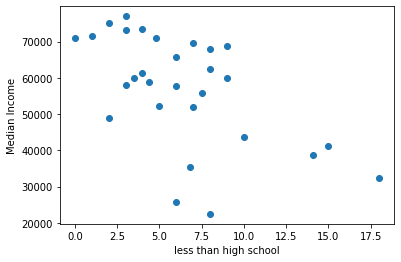

In [ ]:
plt.scatter(df['no_edu'],df['median_household_income'])
plt.xlabel('less than high school')
plt.ylabel('Median Income')

Text(0, 0.5, 'Median Income')

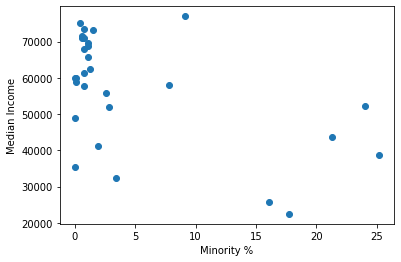

In [ ]:
plt.scatter(df['black']+df['hispanic'],df['median_household_income'])
plt.xlabel('Minority %')
plt.ylabel('Median Income')

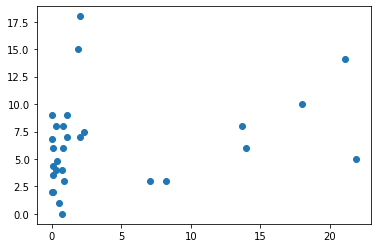

In [ ]:
plt.scatter(df['black'],df['no_edu'])

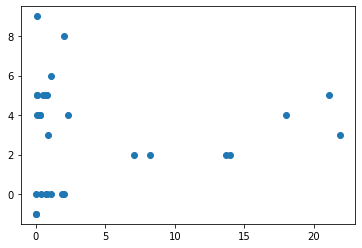

In [ ]:
plt.scatter(df['black'],df['Unemployment_rate'])